<a href="https://colab.research.google.com/github/Ekta-kature/FMMLprojectsandlab/blob/main/Module_8_lab_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Bayesian Machine Learning: Lab 1 - Introduction to Probability Theory

In [3]:
import os

import numpy as np
import pandas as pd

from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as pg

import tensorflow as tf
import tensorflow_probability as tfp

In [4]:
plt.style.use('ggplot')

## Visualizing Gaussian Distribution Functions

Most measurements of real valued quantities can be reasonably modelled with Gaussian distributions, so they are ubiquitous in Bayesian models. Let's take a look and get a feel of the structure of these distributions and how they work in higher dimentional spaces.

Let's first take a look at the Gaussian distribution changing with change in parameters. The following 2 visualizations show the change of the gaussian with the mean and variance.

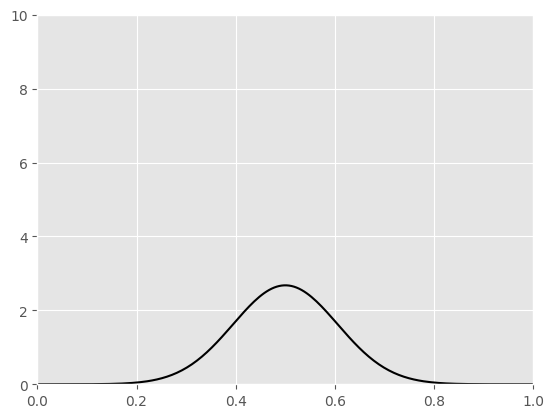

In [6]:
import math
from matplotlib import rc
from matplotlib.animation import FuncAnimation
rc('animation', html='jshtml')


def gaussian_pdf(x, a, b):
    return (1 / np.sqrt(2 * np.pi * b * b))* np.exp(-(x - a)**2 / (b ** 2))

class UpdateDist:

    def __init__(self, ax, prob=0.5):
        self.success = 0
        self.line, = ax.plot([], [], 'k-')
        self.x = np.linspace(0, 1, 200)
        self.ax = ax

        # Set up plot parameters
        self.ax.set_xlim(0, 1)
        self.ax.set_ylim(0, 10)
        self.ax.grid(True)

    def __call__(self, i):
        # This way the plot can continuously run and we just keep
        # watching new realizations of the process
        if i == 0:
            self.mean = 0.5
            self.var = 0.050
            self.line.set_data([], [])
            return self.line,

        # Choose success based on exceed a threshold with a uniform pick
        self.var += 0.001
        y = gaussian_pdf(self.x, self.mean, self.var)
        self.line.set_data(self.x, y)
        return self.line,


fig, ax = plt.subplots()
ud = UpdateDist(ax)
anim = FuncAnimation(fig, ud, frames=100, interval=200, blit=True)

anim

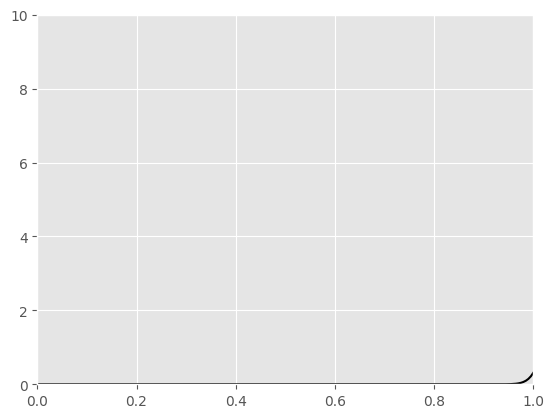

In [7]:
import math
from matplotlib import rc
from matplotlib.animation import FuncAnimation
rc('animation', html='jshtml')


def gaussian_pdf(x, a, b):
    return (1 / np.sqrt(2 * np.pi * b * b))* np.exp(-(x - a)**2 / (b ** 2))

class UpdateDist:

    def __init__(self, ax, prob=0.5):
        self.success = 0
        self.line, = ax.plot([], [], 'k-')
        self.x = np.linspace(0, 1, 200)
        self.ax = ax

        # Set up plot parameters
        self.ax.set_xlim(0, 1)
        self.ax.set_ylim(0, 10)
        self.ax.grid(True)

    def __call__(self, i):
        # This way the plot can continuously run and we just keep
        # watching new realizations of the process
        if i == 0:
            self.mean = 0.1
            self.var = 0.050
            self.line.set_data([], [])
            return self.line,

        # Choose success based on exceed a threshold with a uniform pick
        self.mean += 0.01
        y = gaussian_pdf(self.x, self.mean, self.var)
        self.line.set_data(self.x, y)
        return self.line,


fig, ax = plt.subplots()
ud = UpdateDist(ax)
anim = FuncAnimation(fig, ud, frames=100, interval=200, blit=True)

anim

### Higher Dimentional Plots

Following is an interactive plot of a 2D Gaussian. The plot is in 3D, since the 3rd axis represents the value of the Gaussian as a function of the first two variables.
**Hover your mouse on the Gaussian, you can see the contours of the 2 marginal 1-D Gaussians.**

In [8]:
scan = np.linspace(-200, 200, 500)
x, y = np.meshgrid(scan, scan)
z = np.exp(-(x ** 2 + y ** 2) / (70.0) ** 2)

fig = pg.Figure(data=[pg.Surface(x=y, y=x, z=z)])
fig.update_traces(contours_z=dict(show=True,
                                    usecolormap=True,
                                    highlightcolor="limegreen",
                                    project_z=True))
fig.update_layout(title="2D Gaussian", autosize=False,
                    scene_camera_eye=dict(x=1.5, y=-1.5, z=1.5),
                    width=1200, height=600,
                    margin=dict(l=50, r=50, b=50, t=50))
fig.show()

In [9]:
x, y, z = np.random.normal(size=10000), np.random.normal(size=10000), np.random.normal(size=10000)
v = np.exp(-(x ** 2 + y ** 2 + z ** 2) / (70.0) ** 2)

fig = pg.Figure(data=[pg.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=3,
        color=v,                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()


In [12]:
strong_farmers = 180
weak_farmers = 20
strong_librarians = 6
weak_librarians = 4

In [13]:
# Defining our priors and posteriors
total_farmers = strong_farmers + weak_farmers
total_librarians = strong_librarians + weak_librarians
likelihood_weak = tf.constant([weak_farmers / total_farmers, weak_librarians / total_librarians])
likelihood_strong = tf.constant([strong_farmers / total_farmers, strong_librarians / total_librarians])

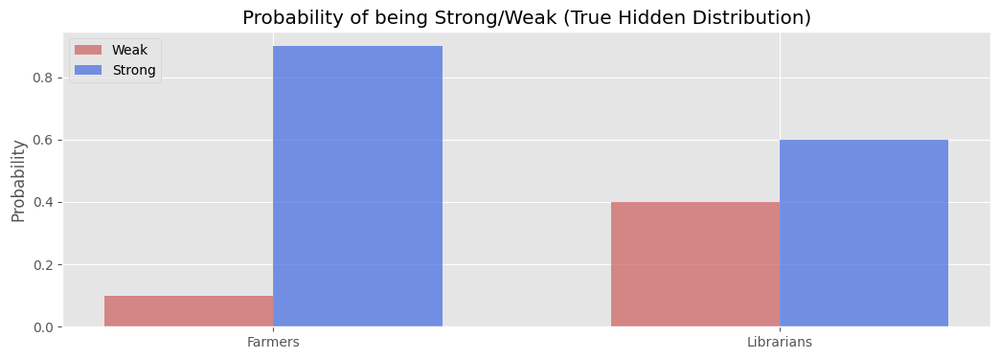

In [14]:
# Our Simple Visualization
plt.figure(figsize=(12.5, 4))
plt.bar([0.00, 0.75], likelihood_weak, alpha=0.70, width=0.25, color='IndianRed', lw=3)
plt.bar([0.25, 1.00], likelihood_strong, alpha=0.7, width=0.25, color='RoyalBlue', lw=3)

plt.xticks([0.125, 0.875], ["Farmers", "Librarians"])
plt.title(r"Probability of being Strong/Weak (True Hidden Distribution)")
plt.ylabel("Probability")
plt.legend(["Weak", "Strong"], loc="upper left");

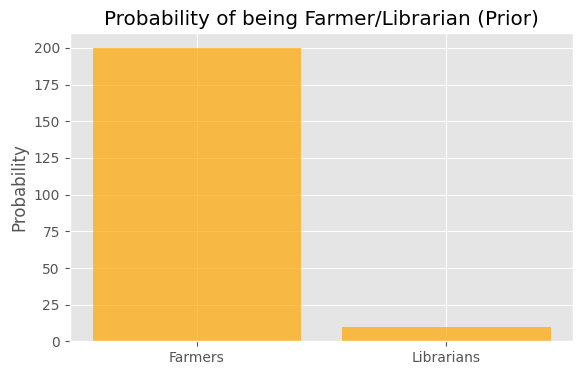

In [15]:
plt.figure(figsize=(6.5, 4))
plt.bar([0.25, 0.55], [total_farmers, total_librarians], alpha=0.7, width=0.25, color='Orange', lw=3)
plt.xticks([0.25, 0.55], ["Farmers", "Librarians"])

plt.title(r"Probability of being Farmer/Librarian (Prior)")
plt.ylabel("Probability")
plt.show()

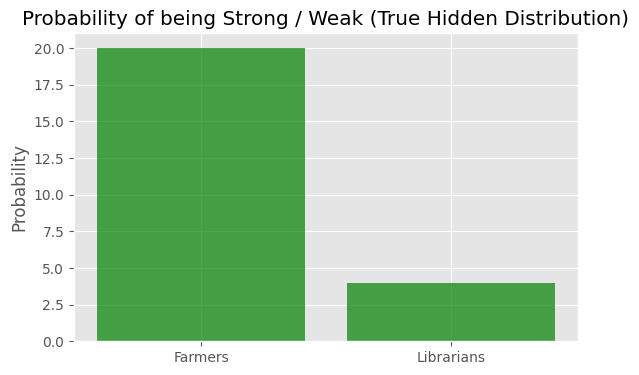

In [16]:
plt.figure(figsize=(6.5, 4))
plt.bar([0.25, 0.55], [weak_farmers, weak_librarians], alpha=0.7, width=0.25, color='Green', lw=3)
plt.xticks([0.25, 0.55], ["Farmers", "Librarians"])

plt.title(r"Probability of being Strong / Weak (True Hidden Distribution)")
plt.ylabel("Probability")
plt.show()

### Maximum Likelihood Estimate vs. Maximum A'posteriori Estimate

Believing that the person is a librarian based on the evidence alone is called the Maximum Likelihood Estimate of the problem.

Believing that the person is a farmer because you factored in prior probabilities is called the Maximum A'posteriori Estimate of the problem.

## Posterior Pulling - Is a coin truly fair?

You and your friend play cricket everyday, and you toss a coin to decide who bats. You are suspicious that your friend is cheating, so you want to use the observations of the toss everyday to conclude what the probability distribution over the tosses looks like.

* Start off with a Prior Distribution, either uniform, if you nothing about the coin yet, or something more biased, like you believe initially that the coin comes up heads more times than tails because your friend likes heads.
* Observe the result of the coin toss each day. Use this data to update your belief state

Let's first try to take a look at the probability function evolving in time. It initially starts off as our uniform prior and rapidly evolves into a stabler (not changing as much in time as it was initially) and sharper (more probability concentrated in less space).

### Live Example of Updates

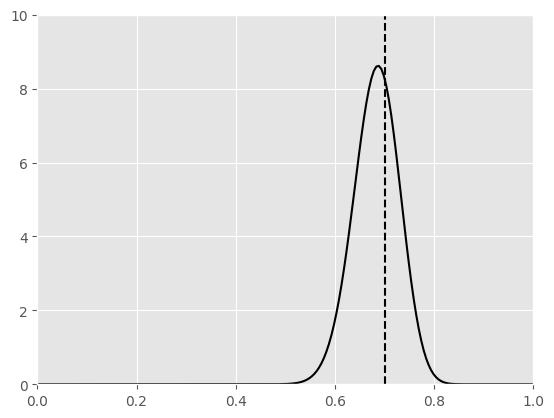

In [17]:
import math
from matplotlib import rc
from matplotlib.animation import FuncAnimation
rc('animation', html='jshtml')


def beta_pdf(x, a, b):
    return (x**(a-1) * (1-x)**(b-1) * math.gamma(a + b)
            / (math.gamma(a) * math.gamma(b)))

class UpdateDist:

    def __init__(self, ax, prob=0.5):
        self.success = 0
        self.prob = prob
        self.line, = ax.plot([], [], 'k-')
        self.x = np.linspace(0, 1, 200)
        self.ax = ax

        # Set up plot parameters
        self.ax.set_xlim(0, 1)
        self.ax.set_ylim(0, 10)
        self.ax.grid(True)

        # This vertical line represents the theoretical value, to
        # which the plotted distribution should converge.
        self.ax.axvline(prob, linestyle='--', color='black')

    def __call__(self, i):
        # This way the plot can continuously run and we just keep
        # watching new realizations of the process
        if i == 0:
            self.success = 0
            self.line.set_data([], [])
            return self.line,

        # Choose success based on exceed a threshold with a uniform pick
        if np.random.rand(1,) < self.prob:
            self.success += 1
        y = beta_pdf(self.x, self.success + 1, (i - self.success) + 1)
        self.line.set_data(self.x, y)
        return self.line,


fig, ax = plt.subplots()
ud = UpdateDist(ax, prob=0.7)
anim = FuncAnimation(fig, ud, frames=100, interval=200, blit=True)

anim

In [18]:
def plot_evolution(p_heads_real, prior_strength, p_heads_init, color='RoyalBlue'):

    # Initialize our Prior, and draw 2000 samples from it
    num_trials = tf.constant([0, 1, 2, 3, 4, 5, 8, 15, 50, 500, 1000, 2000])
    prior = tfp.distributions.Bernoulli(probs=p_heads_real, dtype=tf.int32)
    samples = tf.pad(prior.sample(num_trials[-1]), tf.constant([[1, 0,]]),"CONSTANT")

    # Compute cumulative headcounts from 0 to 2000 flips, and then grab them at each of num_trials intervals
    cumulative_headcounts = tf.gather(tf.cumsum(samples), num_trials)

    # Update the belief state, which is the posterior (we are using a Beta function to store our belief, this can be change)
    rv_observed_heads = tfp.distributions.Beta(
        concentration1=tf.cast(int(prior_strength * p_heads_init) + cumulative_headcounts, tf.float32),
        concentration0=tf.cast(int(prior_strength * (1 - p_heads_init)) + num_trials - cumulative_headcounts, tf.float32))

    # Prepare the probability density function is a form that we can plot it
    probs_of_heads = tf.linspace(start=0., stop=1., num=100, name="linspace")
    observed_probs_heads = tf.transpose(rv_observed_heads.prob(probs_of_heads[:, tf.newaxis]))

    # Go ahead and Plot the functions
    plt.figure(figsize=(12, 30))
    for i in range(len(num_trials)):
        sx = plt.subplot(len(num_trials), 1, i+1)
        plt.xlabel("$f$, fraction of heads")
        plt.ylabel("$p(f)$, probability")
        plt.setp(sx.get_yticklabels(), visible=False)
        plt.plot(probs_of_heads, observed_probs_heads[i], label="%d tosses\n%d heads\n%d tails " % (
            num_trials[i], num_trials[i] - cumulative_headcounts[i], cumulative_headcounts[i]), color=color)
        plt.fill_between(probs_of_heads, 0, observed_probs_heads[i],  color=color, alpha=0.4)
        plt.vlines(0.5, 0, 4, color="k", linestyles="--", lw=1)
        plt.legend().get_frame().set_alpha(0.4)
        plt.autoscale(tight=True)
    plt.suptitle("Bayesian updating of posterior probabilities\nFair coin starting from Uniform Prior", y=1.02, fontsize=14)
    plt.tight_layout()

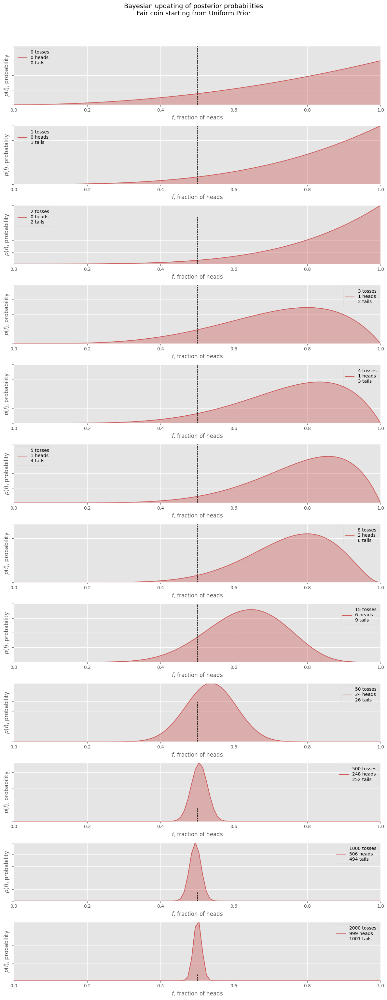

In [19]:
plot_evolution(0.5, 4.0, 0.75, "IndianRed")

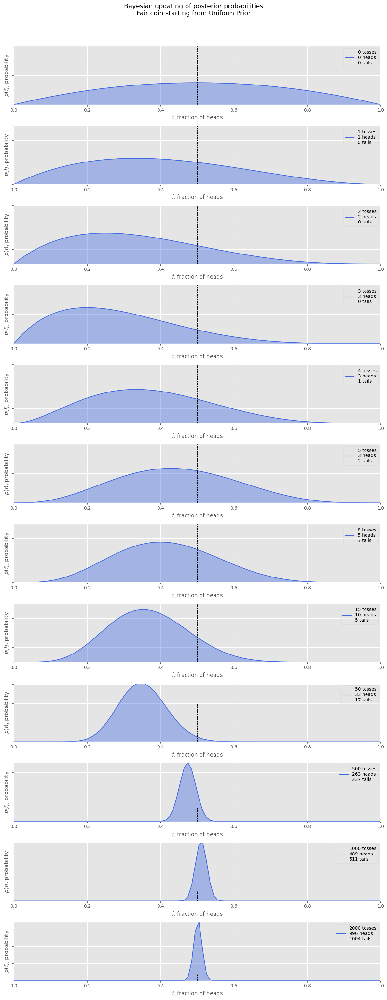

In [20]:
plot_evolution(0.5, 4.0, 0.5, "RoyalBlue")

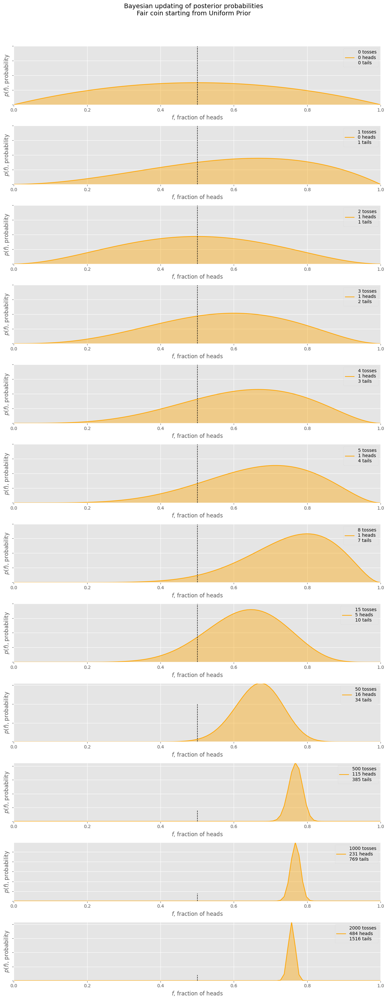

In [21]:
plot_evolution(0.75, 4.0, 0.5, "Orange")

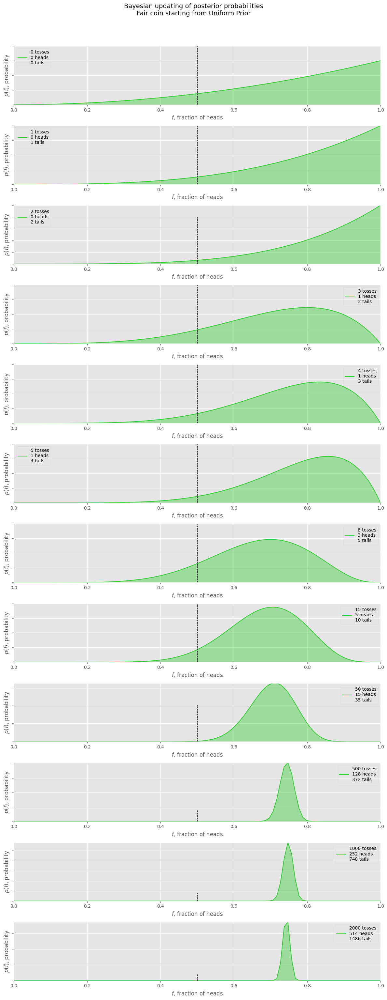

In [22]:
plot_evolution(0.75, 4.0, 0.75, "LimeGreen")